In [1]:
# Import  libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
import requests 
from io import StringIO

## Download data

In [2]:
# download data
def df_from_csv(url):
    response = requests.get(url)
    if response.status_code == 200:
        df = pd.read_csv(StringIO(response.text))
        print(f"CSV file read successfully")
    else:
        print(f"Failed to read CSV. Status code: {response.status_code}")
    return df
csv_url = "https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv"

df = df_from_csv(csv_url)
df.head()

CSV file read successfully


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN


In [3]:
df.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [4]:
#  add column with months instead of full date
df['date'] = pd.to_datetime(df['date'])
df['monthly_date'] = df['date'].dt.to_period('M')

# unfull data for nov 2023, so we delete it 
df = df[df['monthly_date'] < '2023-11']
df

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million,monthly_date
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN,2020-01
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN,2020-01
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN,2020-01
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN,2020-01
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN,2020-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
358775,ZWE,Africa,Zimbabwe,2023-10-27,265867.0,0.0,4.714,5721.0,0.0,0.143,...,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN,2023-10
358776,ZWE,Africa,Zimbabwe,2023-10-28,265867.0,0.0,4.714,5721.0,0.0,0.143,...,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN,2023-10
358777,ZWE,Africa,Zimbabwe,2023-10-29,265867.0,0.0,4.714,5721.0,0.0,0.143,...,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN,2023-10
358778,ZWE,Africa,Zimbabwe,2023-10-30,265890.0,23.0,3.286,5725.0,4.0,0.571,...,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN,2023-10


## Plots

### Bar plot of Total Cases

Bars representing the total number of cases.  
Colors represent the percentage of cases on each continent.  
Line represents the *mean* of total cases via continents.  


The plot helps us see trends over time.  
We see that the growth of case numbers wasn't even: at the beginnig and at the end of the period the plot is more flat, meaning there were less cases of the disease.  
We can also indicate a rapit grows of cases at the begignning of 2022.

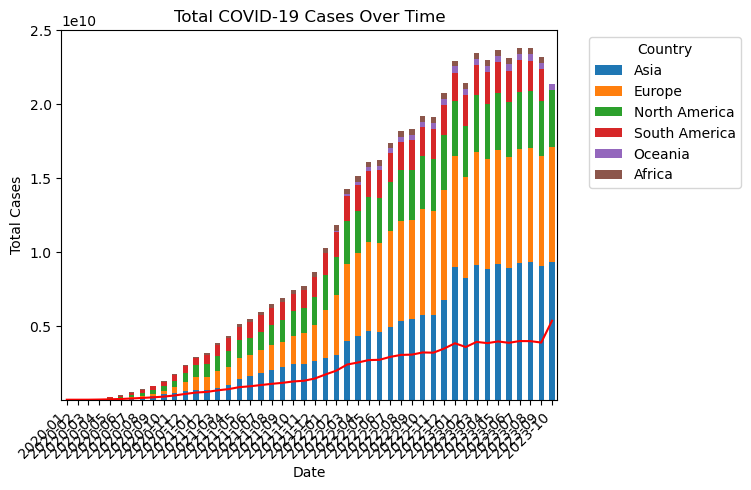

In [5]:
new_cases = df.groupby(['monthly_date', 'continent'])['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases['monthly_date'] = new_cases['monthly_date'].astype(str)

# sns.lineplot(x='monthly_date', y='total_cases', data=new_cases.groupby('monthly_date')['total_cases'].sum().reset_index(), label='Total Cases')
# sns.barplot(x='monthly_date', y='total_cases', hue='continent', data=new_cases)

new_cases_asia = new_cases[new_cases['continent'] == 'Asia'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases_europe = new_cases[new_cases['continent'] == 'Europe'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases_north_ame = new_cases[new_cases['continent'] == 'North America'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases_south_ame = new_cases[new_cases['continent'] == 'South America'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases_oceania = new_cases[new_cases['continent'] == 'Oceania'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])
new_cases_africa = new_cases[new_cases['continent'] == 'Africa'].groupby('monthly_date')['total_cases'].sum(min_count=1).reset_index().dropna(subset=['total_cases'])

new_cases_df=pd.DataFrame({'Asia':new_cases_asia['total_cases'], 
                           'Europe':new_cases_europe['total_cases'], 
                           'North America':new_cases_north_ame['total_cases'], 
                           'South America':new_cases_south_ame['total_cases'], 
                           'Oceania':new_cases_oceania['total_cases'], 
                           'Africa':new_cases_africa['total_cases']
                           }).set_index(new_cases_oceania['monthly_date'])
ax = new_cases_df.plot(kind='bar',stacked=True)
new_cases_df.mean(axis=1, numeric_only=True).plot(ax = ax, color='red')

plt.title('Total COVID-19 Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Total Cases')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


### Time Series Plot of New Cases

Line plot helps us see trends over time.  
The plot shows the number of new cases seperated by Continent.  
We see the rapid growth in the beginning of 2021 mainly happened in Europe,  
and the biggest amount of cases during the first half of 2022 was in Europe and North America.

/var/folders/l2/f21dn1wn2xbg6ynv8vsd0j580000gn/T/ipykernel_13904/1121852533.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reduced_df['date'] = pd.to_datetime(reduced_df['date'])


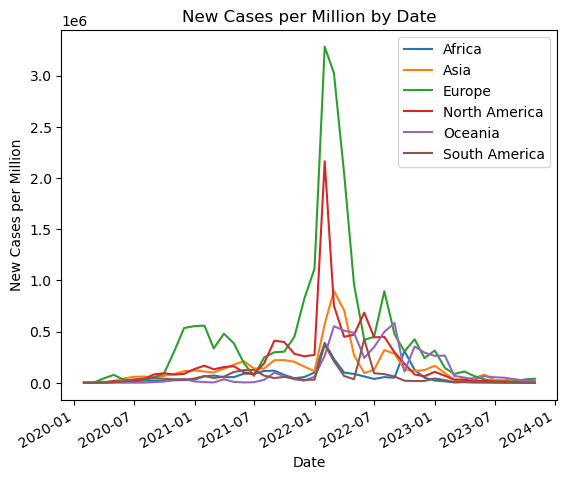

In [6]:
reduced_df = df.dropna(subset=['new_cases_smoothed_per_million', 'date'])
reduced_df['date'] = pd.to_datetime(reduced_df['date'])
groups = reduced_df.groupby('continent')

for name, group in groups:
    monthly_cases = group.groupby(pd.Grouper(key='date', freq='M')).sum(min_count=1, numeric_only=True)['new_cases_smoothed_per_million']
    plt.plot(np.array(monthly_cases.index), np.array(monthly_cases), label=name)

plt.title('New Cases per Million by Date')
plt.xticks(rotation=30, ha='right')
plt.xlabel('Date')
plt.ylabel('New Cases per Million')
plt.legend()
plt.show()

### Scatter Plot with a regression line of Cases Percentage vs. Vaccinations
Scatter plot helps us see correlations.  
The plot shows the corellation between the percentage of cases and vaccinations.  
We see a positive correlation between the two variables.  

/var/folders/l2/f21dn1wn2xbg6ynv8vsd0j580000gn/T/ipykernel_13904/1118130741.py:7: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  vacs_df = df.groupby(['location', 'population', 'continent'])['total_cases', 'people_vaccinated'].max().reset_index()


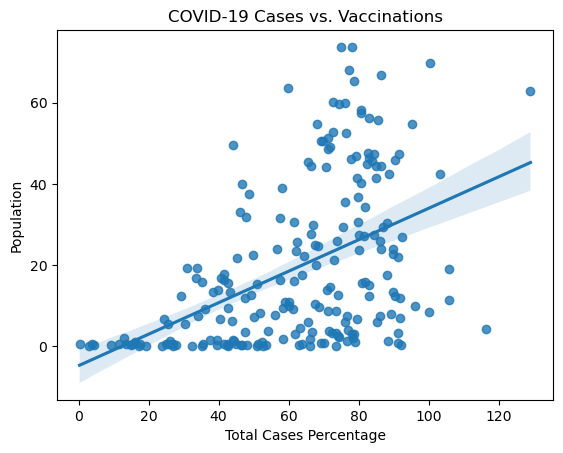

In [7]:
vacs_df = df.groupby(['location', 'population', 'continent'])['total_cases', 'people_vaccinated'].max().reset_index()
vacs_df['cases_percentage'] = vacs_df['total_cases'] / vacs_df['population'] * 100
vacs_df['vacs_percentage'] = vacs_df['people_vaccinated'] / vacs_df['population'] * 100

sns.regplot(y='cases_percentage',
                x='vacs_percentage',
                data=vacs_df) 

plt.title('COVID-19 Cases vs. Vaccinations')
plt.xlabel('Total Cases Percentage')
plt.ylabel('Population')
plt.show()

### Box Plot of Vaccinations
Box Plot represents the range of vaccinated people иy continent.  
We can see that Africa differs a lot from other continent — most people didn't get vaccines.

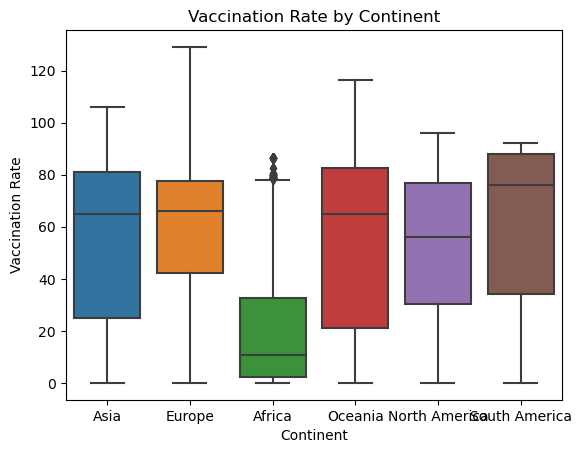

In [8]:
sns.boxplot(x='continent', y='people_vaccinated_per_hundred', data=df)
plt.title('Vaccination Rate by Continent')
plt.xlabel('Continent')
plt.ylabel('Vaccination Rate')
plt.show()

### Map with Number of Deaths by country

#### Map with Number of Deaths by country through time

In [9]:
death_max = max([int(i) for i in df['new_deaths_per_million'].dropna()])
fig = px.choropleth(df, 
                    locations="iso_code", 
                    color="new_deaths_per_million", 
                    hover_name="location", 
                    animation_frame="monthly_date", 
                    # range_color=(0, continent),
                    labels = {"new_deaths_per_million": 'Deaths of 1.000.000'})
fig.show()

#### Map with death percentage
Map represents the death percentage by Country.  
We see that the highest death rate are in Peru, Bulgaria and Bosnia and Herzegovina.

In [10]:
overall_deaths = df.groupby(['iso_code', 'population'])['total_deaths'].max().reset_index()
overall_deaths['death_percent'] = overall_deaths['total_deaths']/overall_deaths['population'] * 100

fig = px.choropleth(overall_deaths, 
                    locations="iso_code", 
                    color="death_percent", 
                    hover_name="iso_code", 
                    title='Deaths by Country',
                    labels={'death_percent': 'Deaths'},
                    color_discrete_map={country: 'red' for country in overall_deaths.sort_values(by='death_percent', ascending=False).head(3)['iso_code']})

fig.show()

### Bar chart with Comparison of Max Hospital patiens and Max ICU patients by  Continent
It helps us compare the maximum number of hospital patients and ICU patients by continen.  
We can see that the in South America was the smallest number of hospital patient overall, 
but the highest percentage of ICU Patients.

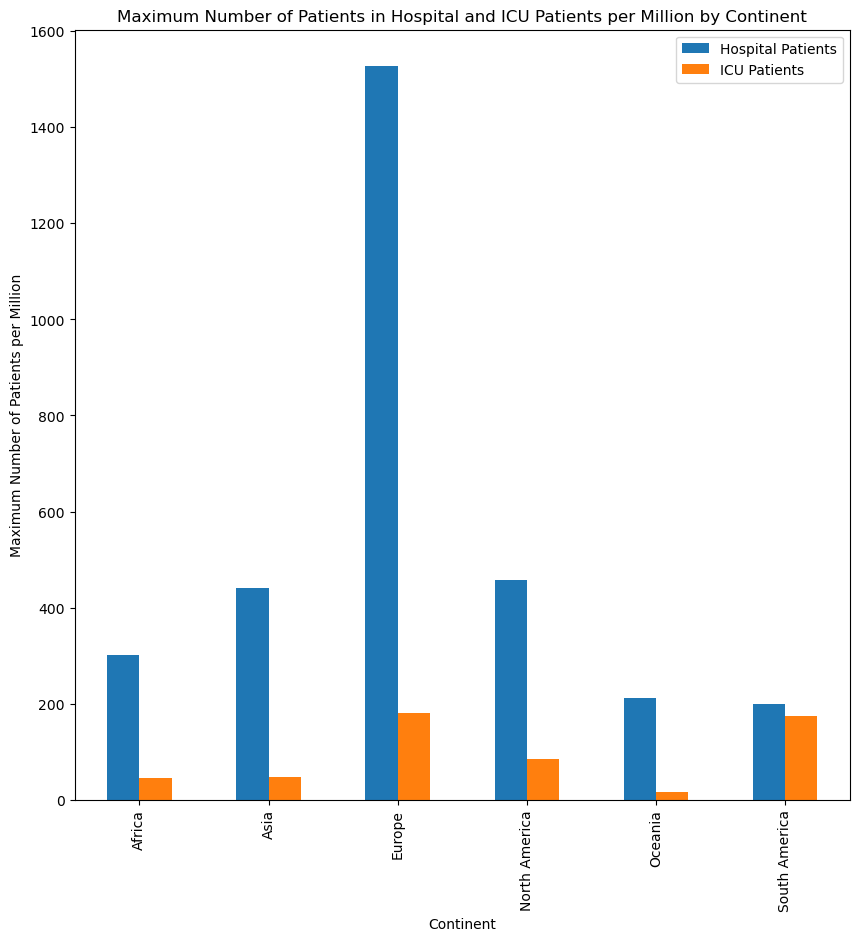

In [11]:
icu_data = df.groupby('continent')[['hosp_patients_per_million', 'icu_patients_per_million']].max()

icu_data.plot(kind='bar', figsize=(10, 10))

plt.xlabel('Continent')
plt.ylabel('Maximum Number of Patients per Million')
plt.title('Maximum Number of Patients in Hospital and ICU Patients per Million by Continent')
plt.legend(['Hospital Patients', 'ICU Patients'])

plt.show()
